In [1]:
import numpy as np
from skimage.io import imread
import scipy
from scipy.stats import pearsonr
import matplotlib.pyplot as plt

/home/yang158/pythonenvs/py3.8/lib/python3.8/site-packages/skimage/io/manage_plugins.py:23: UserWarning: Your installed pillow version is < 8.1.2. Several security issues (CVE-2021-27921, CVE-2021-25290, CVE-2021-25291, CVE-2021-25293, and more) have been fixed in pillow 8.1.2 or higher. We recommend to upgrade this library.
  from .collection import imread_collection_wrapper


In [2]:
import time

In [3]:
from mpl_toolkits import mplot3d
from matplotlib import cm


In [127]:
def get_offset(base,channel):
    base_fft = np.fft.fftshift(np.fft.fft2(base))
    channel_c = np.conjugate(np.fft.fftshift(np.fft.fft2(channel)))
    corr = np.fft.ifft2(base_fft * channel_c)
    my,mx = np.unravel_index(abs(corr).argmax(),corr.shape)
    
    return my,mx,np.amax(abs(corr)),corr
    

## Preprocess the first image

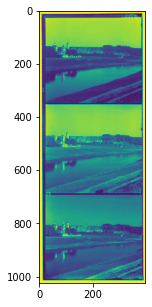

In [4]:
img = imread('./00125v.jpg')

plt.figure(figsize=(20,5))
plt.imshow(img)

## Cropping the borders

we first remove the outermost pixels

In [5]:
start1 = 30
end1 = start1+315

In [6]:
start2 = 340+20
end2 = start2+315

In [7]:
start3 = 330+25+320+20
end3 = start3+315
#plt.figure(figsize=(20,20))
#plt.imshow(img[start3:end3,22:385])

In [8]:
b = img[start1:end1,22:385]
g = img[start2:end2,22:385]
r = img[start3:end3,22:385]

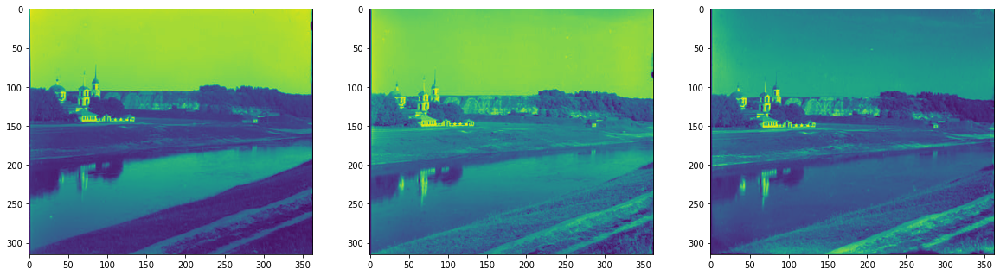

In [9]:
fig,ax = plt.subplots(1,3,figsize=(20,40))
ax[0].imshow(b)
ax[1].imshow(g)
ax[2].imshow(r)

In [21]:
pre_b = scipy.ndimage.gaussian_laplace(b,sigma = 1)
pre_g = scipy.ndimage.gaussian_laplace(g,sigma = 1)
pre_r = scipy.ndimage.gaussian_laplace(r,sigma = 1)

## Blue channel as the base image

In [67]:
b_fft = np.fft.fftshift(np.fft.fft2(pre_b))

In [68]:
g_fftc = np.conjugate(np.fft.fftshift(np.fft.fft2(pre_g)))
r_fftc = np.conjugate(np.fft.fftshift(np.fft.fft2(pre_r)))

In [69]:
corr1 = np.fft.ifft2(b_fft * g_fftc)
corr2 = np.fft.ifft2(b_fft * r_fftc)


In [70]:
np.amax(abs(corr1)) + np.amax(abs(corr2))

1745530297.9999998

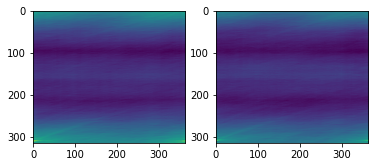

In [71]:
fig,ax = plt.subplots(1,2)
ax[0].imshow(abs(corr1))
ax[1].imshow(abs(corr2))

In [72]:
y1,x1 = np.unravel_index(np.argmax(corr1),corr1.shape)
y2,x2 = np.unravel_index(np.argmax(corr2),corr2.shape)

In [73]:
print(y1,x1,y2,x2)

310 1 308 1


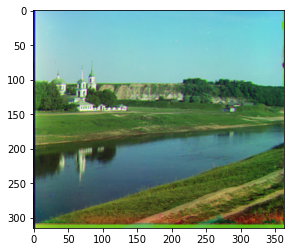

In [77]:
shifted_g = np.roll(g,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

## Green channel as the base image

In [78]:
g_fft = np.fft.fftshift(np.fft.fft2(pre_g))

In [79]:
b_fftc = np.conjugate(np.fft.fftshift(np.fft.fft2(pre_b)))
r_fftc = np.conjugate(np.fft.fftshift(np.fft.fft2(pre_r)))

In [80]:
corr1 = np.fft.ifft2(g_fft * b_fftc)
corr2 = np.fft.ifft2(g_fft * r_fftc)

In [81]:
np.amax(abs(corr1)) + np.amax(abs(corr2))

1907081887.9999998

In [ ]:
np.amax(abs(corr1)) + np.amax(abs(corr2))

In [82]:
y1,x1 = np.unravel_index(np.argmax(corr1),corr1.shape)
y2,x2 = np.unravel_index(np.argmax(corr2),corr2.shape)

In [83]:
print(y1,x1,y2,x2)

5 362 313 0


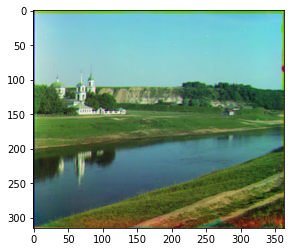

In [84]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

## Red Channel as the base image

In [85]:
r_fft = np.fft.fftshift(np.fft.fft2(pre_r))

In [86]:
b_fftc = np.conjugate(np.fft.fftshift(np.fft.fft2(pre_b)))
g_fftc = np.conjugate(np.fft.fftshift(np.fft.fft2(pre_g)))

In [87]:
corr1 = np.fft.ifft2(r_fft * b_fftc)
corr2 = np.fft.ifft2(r_fft * g_fftc)

In [92]:
np.amax(abs(corr1)) + np.amax(abs(corr2))

1916110413.9999995

In [105]:
y1,x1 = np.unravel_index(np.argmax(abs(corr1)),corr1.shape)
y2,x2 = np.unravel_index(np.argmax(abs(corr2)),corr2.shape)

In [106]:
y1,x1,y2,x2

(7, 362, 2, 1)

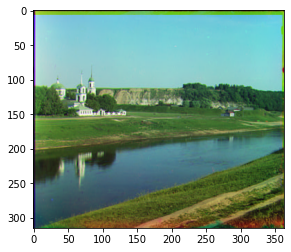

In [107]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_g = np.roll(g,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

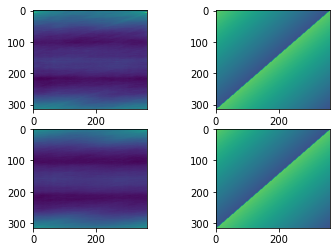

In [108]:
fig,ax = plt.subplots(2,2)
ax[0][0].imshow(abs(corr1))
ax[0][1].imshow(np.angle(corr1))
ax[1][0].imshow(abs(corr2))
ax[1][1].imshow(np.angle(corr2))

In [102]:
y,x,_,_ = get_offset(pre_r,pre_g)

In [103]:
y,x

(2, 1)

## Without Preprocessing

## blue channel

In [ ]:
y1,x1,s1,_ = get_offset(b,g)
y2,x2,s2,_ = get_offset(b,g)
print(y1,x1,y2,x2)

In [ ]:
shifted_g = np.roll(g,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

## green channel

In [ ]:
y1,x1,s1,_ = get_offset(g,b)
y2,x2,s2,_ = get_offset(g,r)
print(y1,x1,y2,x2)

In [ ]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

## red channel

In [ ]:
y1,x1,s1,_ = get_offset(r,b)
y2,x2,s2,_ = get_offset(r,g)
print(y1,x1,y2,x2)

In [ ]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_g = np.roll(g,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

## Preprocess the second image

In [113]:
img = imread('./00149v.jpg')
img.shape
#plt.figure(figsize=(20,5))
#plt.imshow(img)

(1024, 397)

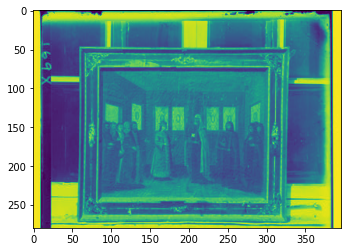

In [114]:
#plt.figure(figsize=(20,5))
plt.imshow(img[10:290])

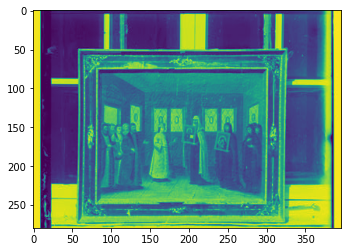

In [115]:
index = 345
#plt.figure(figsize=(20,5))
plt.imshow(img[index:index+280])

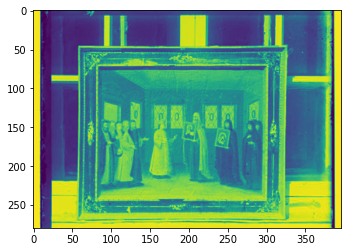

In [116]:
index = 685
#plt.figure(figsize=(20,5))
plt.imshow(img[index:index+280])

In [118]:
b = img[10:290]
#g = img[350:350+280]
g = img[345:345+280]
#r = img[690:690+280]
r = img[685:685+280]

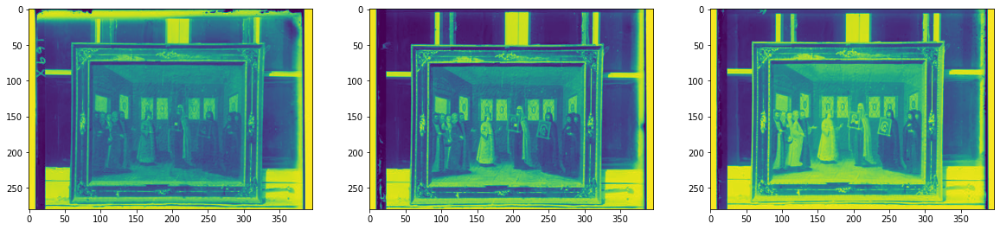

In [119]:
fig,ax = plt.subplots(1,3,figsize=(20,40))
ax[0].imshow(b)
ax[1].imshow(g)
ax[2].imshow(r)

## Preprocess

In [120]:
pre_b = scipy.ndimage.gaussian_laplace(b,sigma = 1)
pre_g = scipy.ndimage.gaussian_laplace(g,sigma = 1)
pre_r = scipy.ndimage.gaussian_laplace(r,sigma = 1)

## Blue channel as the base image

In [128]:
y1,x1,s1,_ = get_offset(pre_b,pre_g)
y2,x2,s2,_ = get_offset(pre_b,pre_r)
print(y1,x1,y2,x2)

278 2 2 2


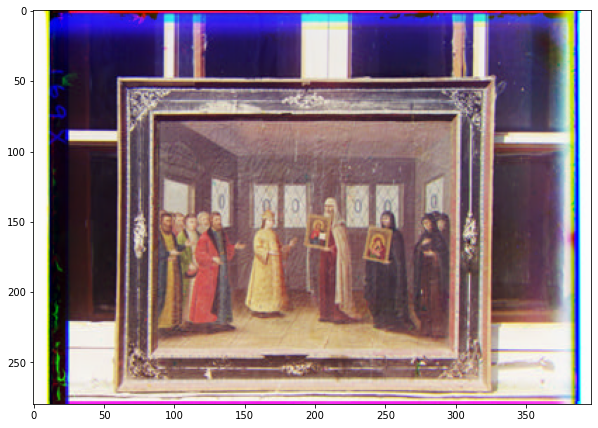

In [129]:
shifted_g = np.roll(g,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [131]:
s1+s2

2891045936.9999995

## Green Channel as the base image

In [132]:
y1,x1,s1,_ = get_offset(pre_g,pre_b)
y2,x2,s2,_ = get_offset(pre_g,pre_r)
print(y1,x1,y2,x2)

2 395 4 0


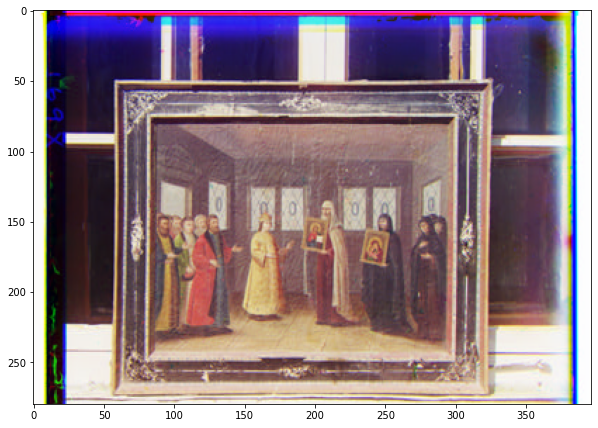

In [133]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

In [134]:
s1+s2

3073764510.999999

## Red channel as the base image

In [135]:
y1,x1,s1,_ = get_offset(pre_r,pre_b)
y2,x2,s2,_ = get_offset(pre_r,pre_g)
print(y1,x1,y2,x2)

278 395 276 0


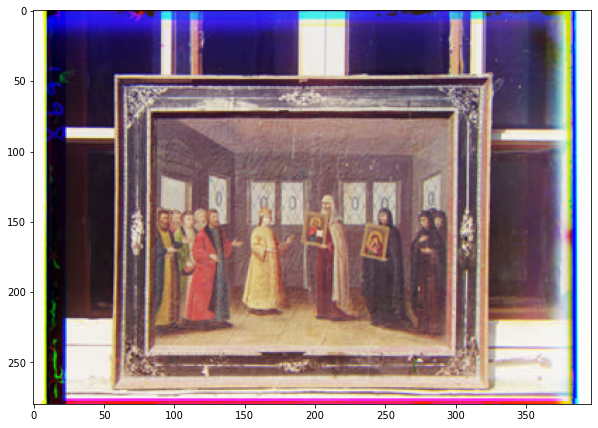

In [136]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_g = np.roll(g,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

In [137]:
s1+s2

3004327098.0

In [138]:
y1,x1,s1,corr1 = get_offset(pre_g,pre_b)
y2,x2,s2,corr2 = get_offset(pre_g,pre_r)
print(y1,x1,y2,x2)

2 395 4 0


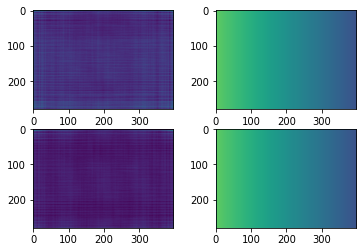

In [139]:
fig,ax = plt.subplots(2,2)
ax[0][0].imshow(abs(corr1))
ax[0][1].imshow(np.angle(corr1))
ax[1][0].imshow(abs(corr2))
ax[1][1].imshow(np.angle(corr2))

## Without Preprocessing

## Blue channel

In [140]:
y1,x1,s1,_ = get_offset(b,g)
y2,x2,s2,_ = get_offset(b,g)
print(y1,x1,y2,x2)

278 1 278 1


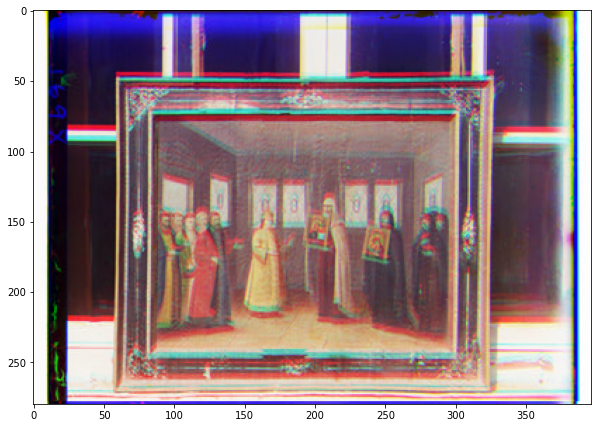

In [141]:
shifted_g = np.roll(g,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [142]:
s1+s2

3934358662.0000014

## Green channel

In [143]:
y1,x1,s1,_ = get_offset(g,b)
y2,x2,s2,_ = get_offset(g,r)
print(y1,x1,y2,x2)

2 396 4 0


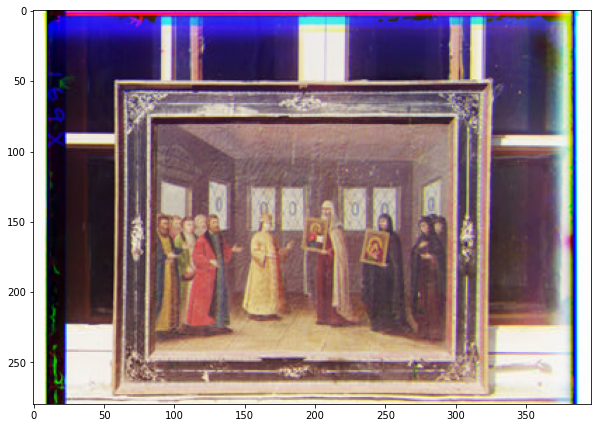

In [144]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

In [146]:
s1+s2

4257495686.999999

## Red channel

In [148]:
y1,x1,s1,_ = get_offset(r,b)
y2,x2,s2,_ = get_offset(r,g)
print(y1,x1,y2,x2)

278 396 276 0


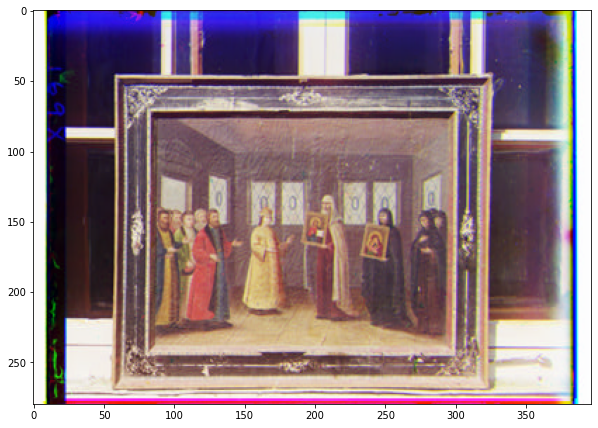

In [149]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_g = np.roll(g,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

In [150]:
s1+s2

4515361594.0

## Preprocessing 3rd image


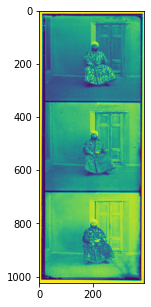

In [53]:
img = imread('./00153v.jpg')

plt.figure(figsize=(20,5))
plt.imshow(img)

In [54]:
img.shape

(1024, 394)

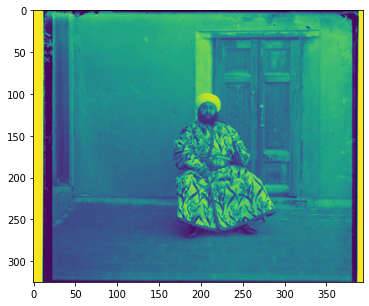

In [55]:
index = 15
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+325])

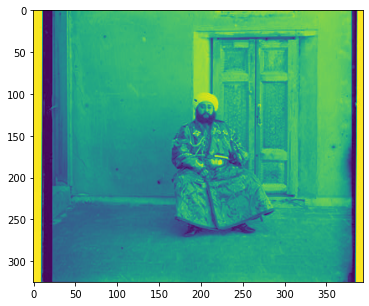

In [56]:
index = 350
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+325])

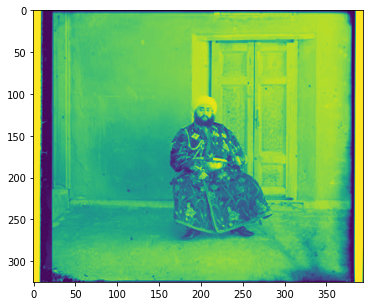

In [57]:
index = 680
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+325])

In [58]:
b = img[15:15+325]
#g = img[350:350+280]
g = img[350:350+325]
#r = img[690:690+280]
r = img[680:680+325]

## Blue channel as the base image

In [59]:
S1,y1,x1 = get_offset(norm(b),norm(g))
S2,y2,x2 = get_offset(norm(b),norm(r))
print(y1,x1,y2,x2)

1 2 0 3


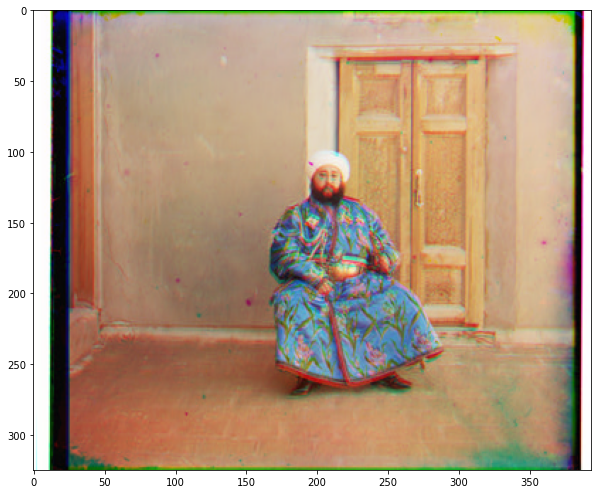

In [60]:
shifted_g = np.roll(g,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

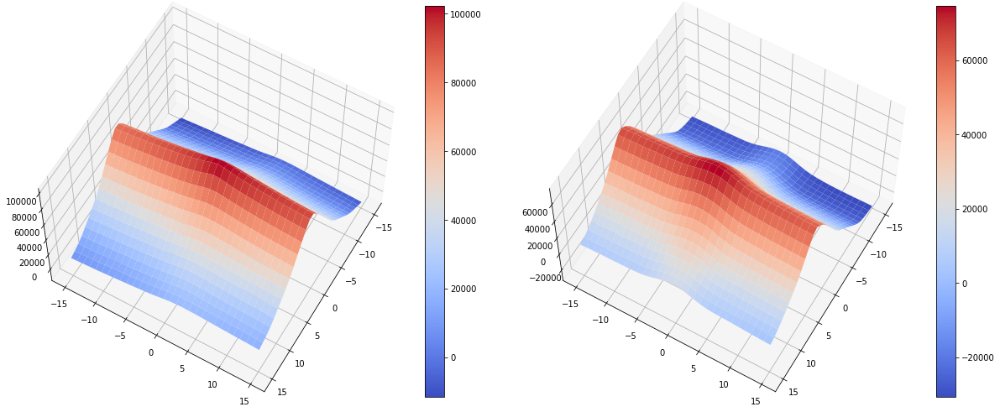

In [61]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [62]:
S1.max()+S2.max()

179748.40137699083

## Green channel as the base channel

In [63]:
S1,y1,x1 = get_offset(norm(g),norm(b))
S2,y2,x2 = get_offset(norm(g),norm(r))
print(y1,x1,y2,x2)

-1 -2 -4 2


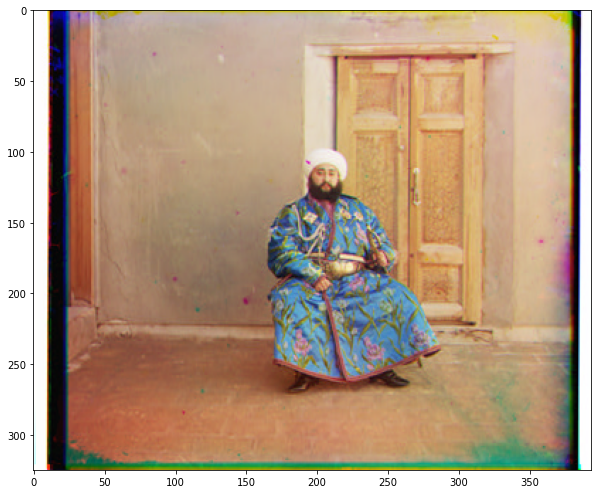

In [64]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

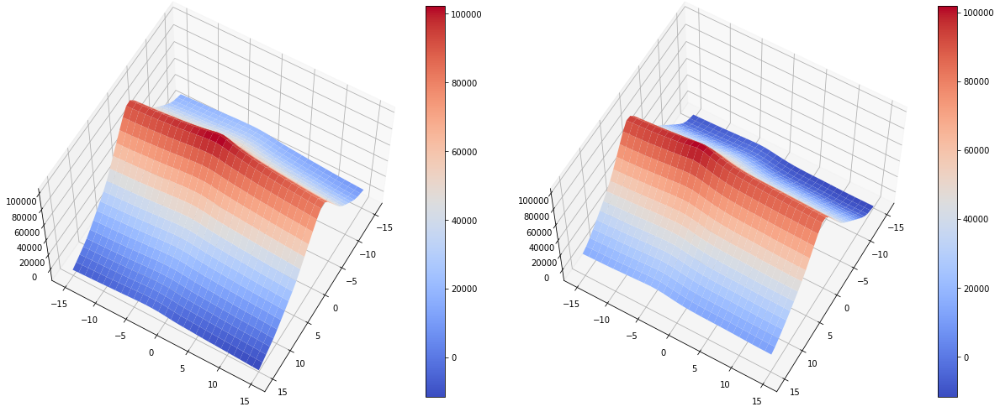

In [65]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [66]:
S1.max()+S2.max()

206789.96968180587

## Red channel as the base image

In [67]:
S1,y1,x1 = get_offset(norm(r),norm(b))
S2,y2,x2 = get_offset(norm(r),norm(g))
y1,x1,y2,x2

(0, -3, 4, -2)

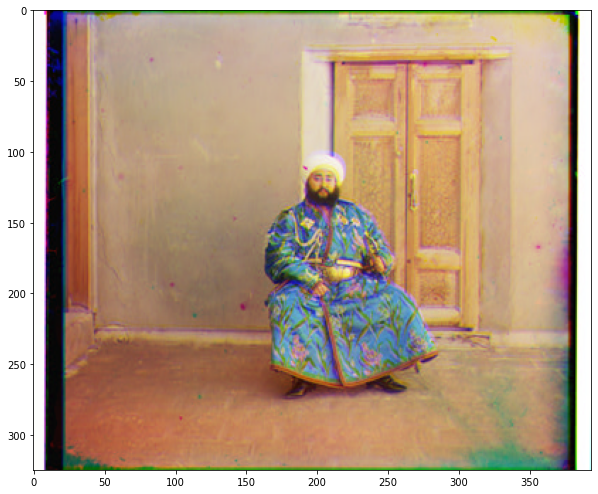

In [68]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_g = np.roll(g,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

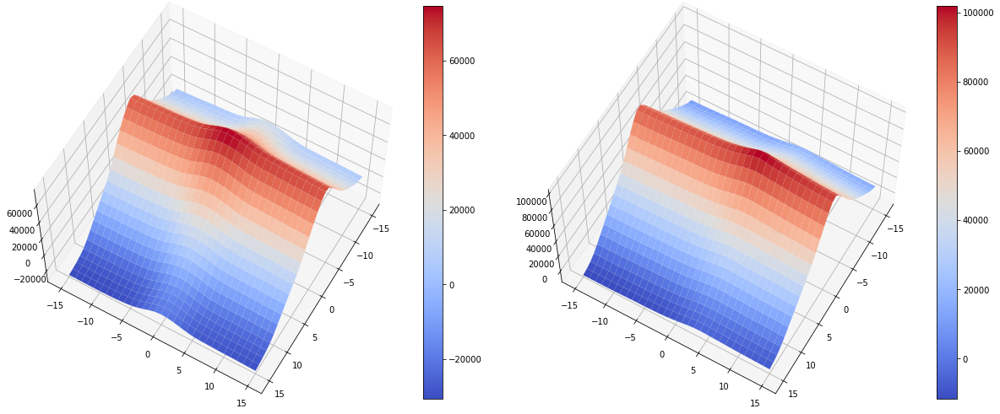

In [69]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [70]:
S1.max()+S2.max()

178971.65900978795

## Preprocess the 4th image

(1024, 396)

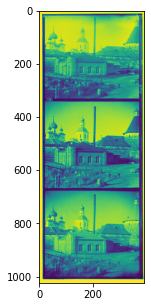

In [71]:
img = imread('./00351v.jpg')

plt.figure(figsize=(20,5))
plt.imshow(img)
img.shape

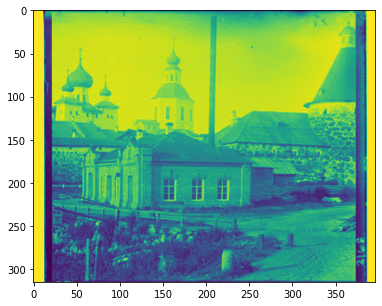

In [72]:
index = 15
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+315])

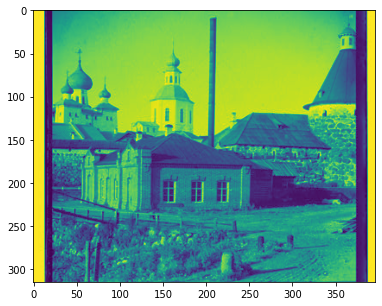

In [73]:
index = 350
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+315])

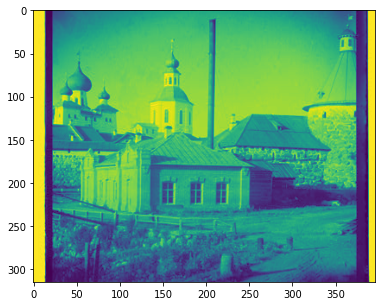

In [74]:
index = 680
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+315])

In [75]:
b = img[15:15+315]
#g = img[350:350+280]
g = img[350:350+315]
#r = img[690:690+280]
r = img[680:680+315]

## Blue channel as the base image

In [76]:
S1,y1,x1 = get_offset(norm(b),norm(g))
S2,y2,x2 = get_offset(norm(b),norm(r))
print(y1,x1,y2,x2)

-2 0 -4 -1


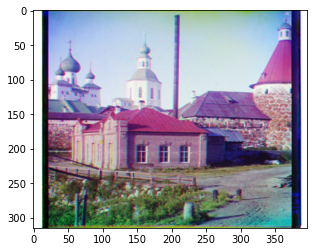

In [77]:
shifted_g = np.roll(g,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

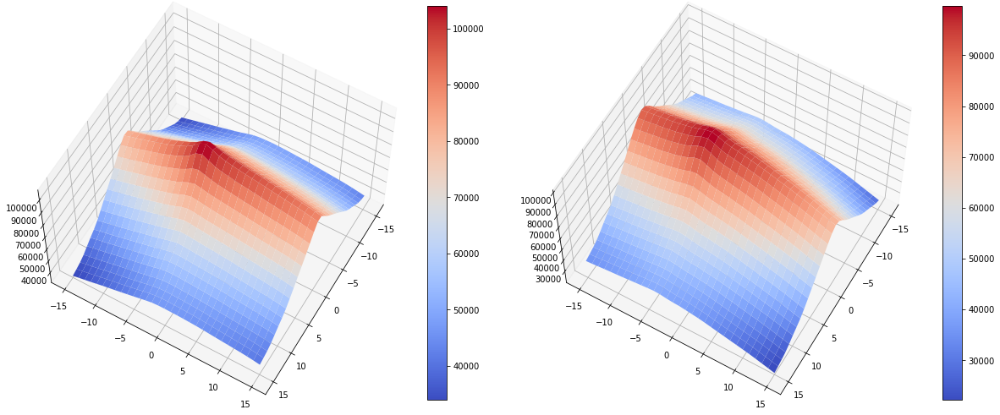

In [78]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [79]:
S1.max()+S2.max()

206914.40183890678

## Green channel as the base image

In [80]:
S1,y1,x1 = get_offset(norm(g),norm(b))
S2,y2,x2 = get_offset(norm(g),norm(r))
print(y1,x1,y2,x2)

2 0 -2 0


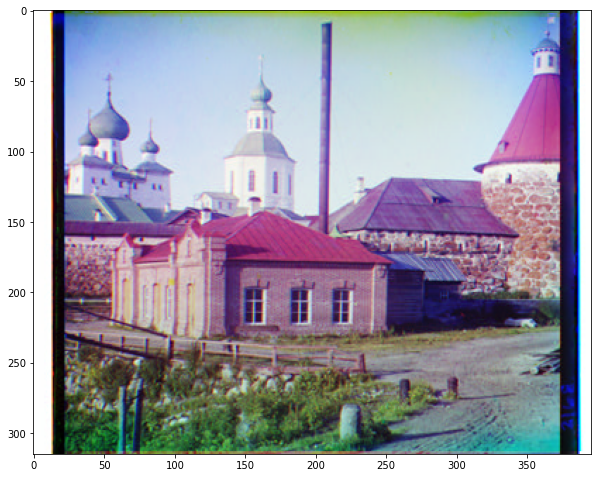

In [81]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

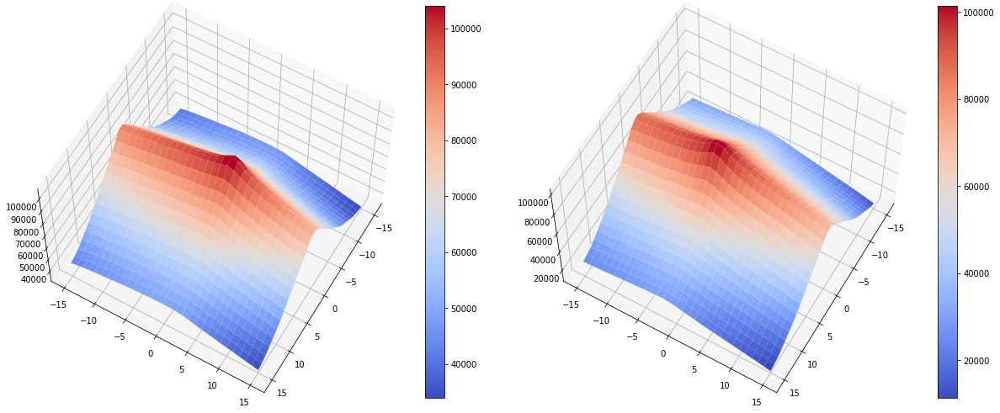

In [82]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [83]:
S1.max()+S2.max()

210159.25270857694

## Red channel as the base image

In [84]:
S1,y1,x1 = get_offset(norm(r),norm(b))
S2,y2,x2 = get_offset(norm(r),norm(g))
y1,x1,y2,x2

(4, 1, 2, 0)

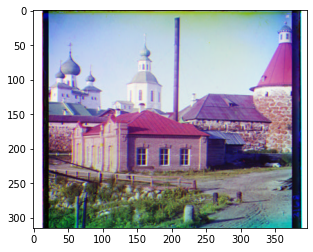

In [85]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_g = np.roll(g,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

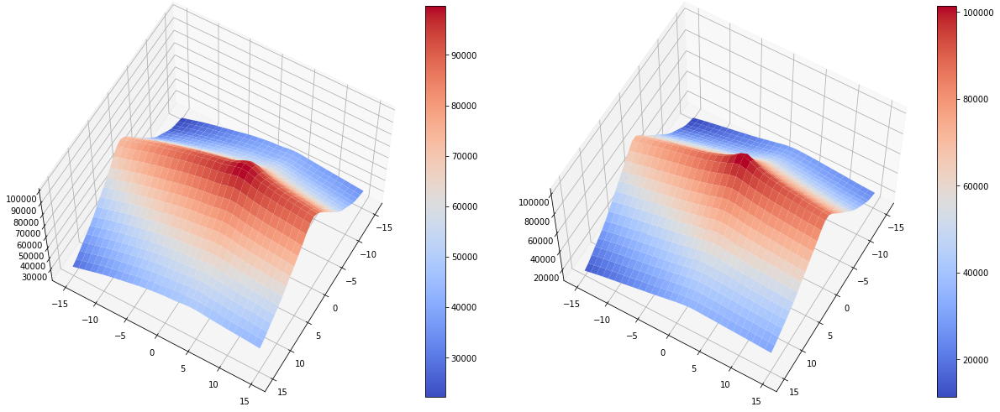

In [86]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [87]:
S1.max()+S2.max()

204485.0791575676

## Preprocess the 5th image

(1024, 397)

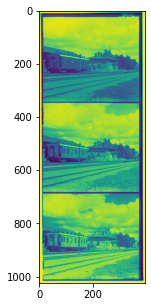

In [88]:
img = imread('./00398v.jpg')

plt.figure(figsize=(20,5))
plt.imshow(img)
img.shape

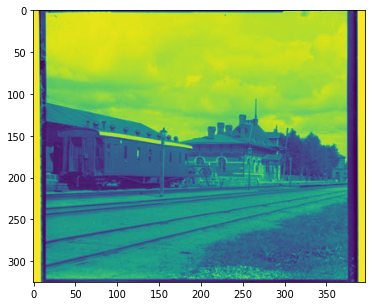

In [89]:
index = 20
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+325])

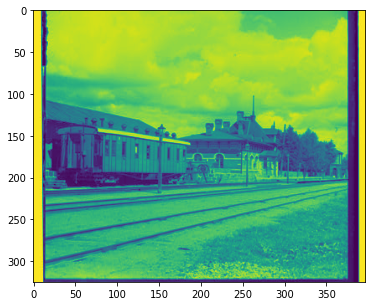

In [90]:
index = 360
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+325])

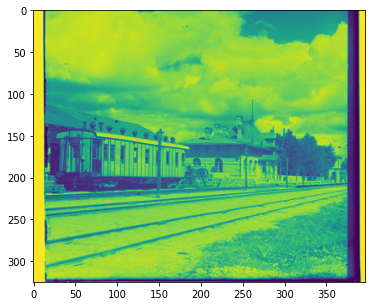

In [91]:
index = 690
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+325])

In [92]:
b = img[20:20+325]
#b = img[15:15+330]
#g = img[350:350+325]
g = img[360:360+325]
r = img[690:690+325]
#r = img[685:685+325]

## Blue channel

In [93]:
S1,y1,x1 = get_offset(norm(b),norm(g))
#S1,y1,x1 = get_multi_offset(norm(b),norm(g),np.arange(-20,21),np.arange(-20,21))
S2,y2,x2 = get_offset(norm(b),norm(r))
#S2,y2,x2 = get_multi_offset(norm(b),norm(g),np.arange(-20,21),np.arange(-20,21))

print(y1,x1,y2,x2)

3 -1 0 -2


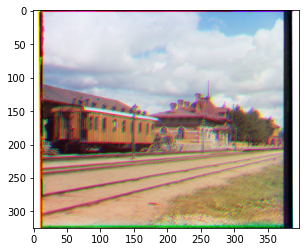

In [94]:
shifted_g = np.roll(g,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

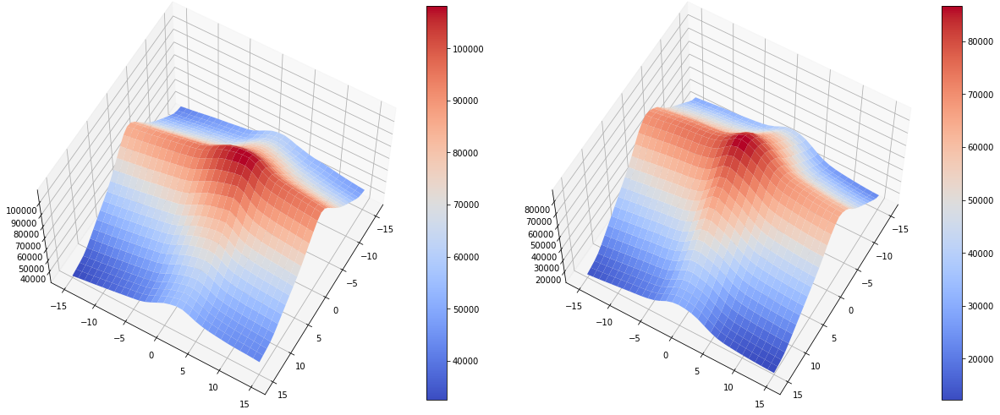

In [95]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [96]:
S1.max()+S2.max()

197010.65786166233

## Green channel

In [97]:
S1,y1,x1 = get_offset(norm(g),norm(b))
S2,y2,x2 = get_offset(norm(g),norm(r))
print(y1,x1,y2,x2)

-3 1 -5 -1


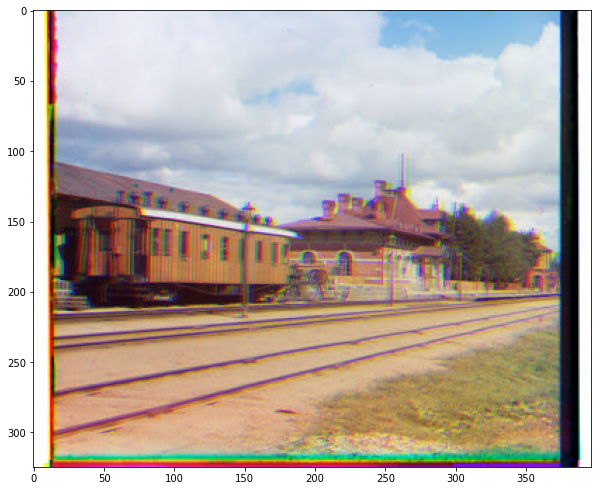

In [98]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

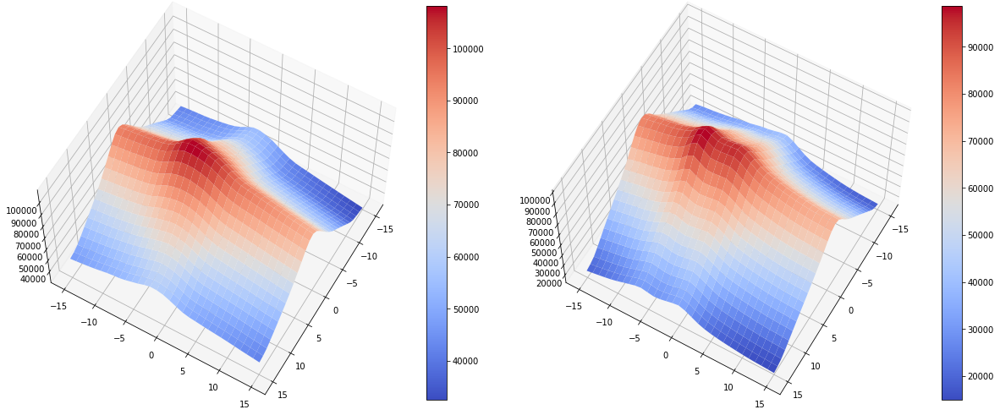

In [99]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [100]:
S1.max()+S2.max()

209412.66813472466

## Red channel

In [101]:
S1,y1,x1 = get_offset(norm(r),norm(b))
S2,y2,x2 = get_offset(norm(r),norm(g))
y1,x1,y2,x2

(0, 2, 5, 1)

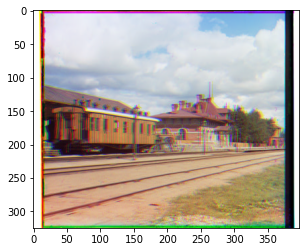

In [102]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_g = np.roll(g,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

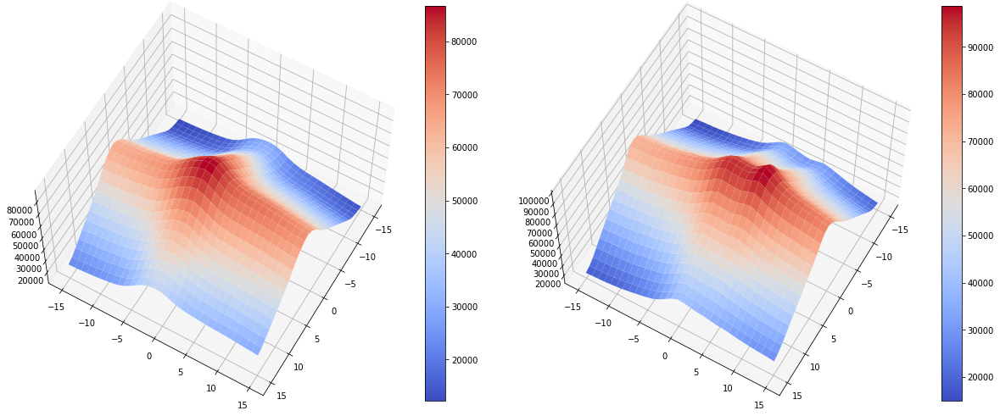

In [103]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [104]:
S1.max()+S2.max()

188254.88964879364

## Preprocessing the 6th image

(1024, 393)

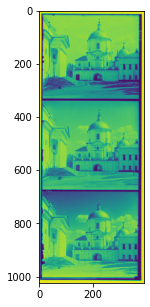

In [105]:
img = imread('./01112v.jpg')

plt.figure(figsize=(20,5))
plt.imshow(img)
img.shape

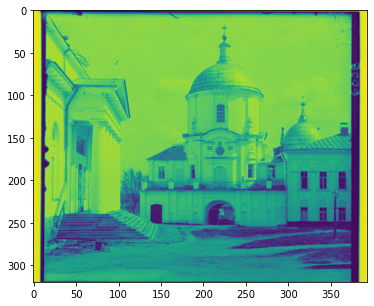

In [106]:
index = 10
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+320])

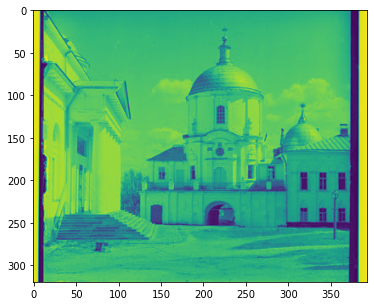

In [107]:
index = 350
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+320])

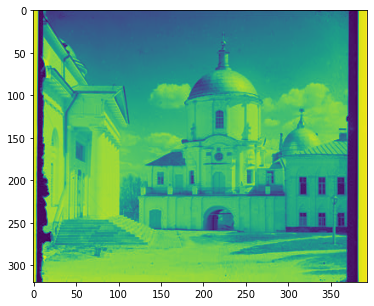

In [108]:
index = 680
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+320])

In [109]:
b = img[10:10+320]
#b = img[15:15+330]
g = img[350:350+320]
#g = img[345:345+330]
#r = img[685:685+330]
r = img[680:680+320]

## Blue channel

In [110]:
S1,y1,x1 = get_offset(norm(b),norm(g))
S2,y2,x2 = get_offset(norm(b),norm(r))
print(y1,x1,y2,x2)

-1 1 -7 2


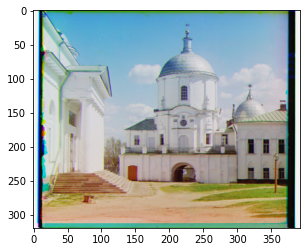

In [111]:
shifted_g = np.roll(g,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

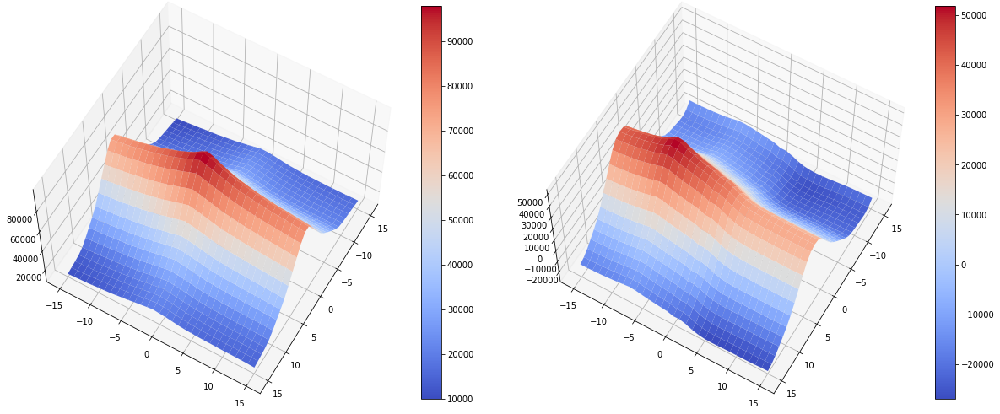

In [112]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [113]:
S1.max()+S2.max()

152273.85847448444

## Green channel

In [114]:
S1,y1,x1 = get_offset(norm(g),norm(b))
S2,y2,x2 = get_offset(norm(g),norm(r))
print(y1,x1,y2,x2)

1 -1 -6 1


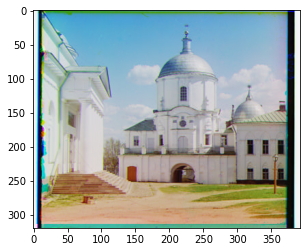

In [115]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

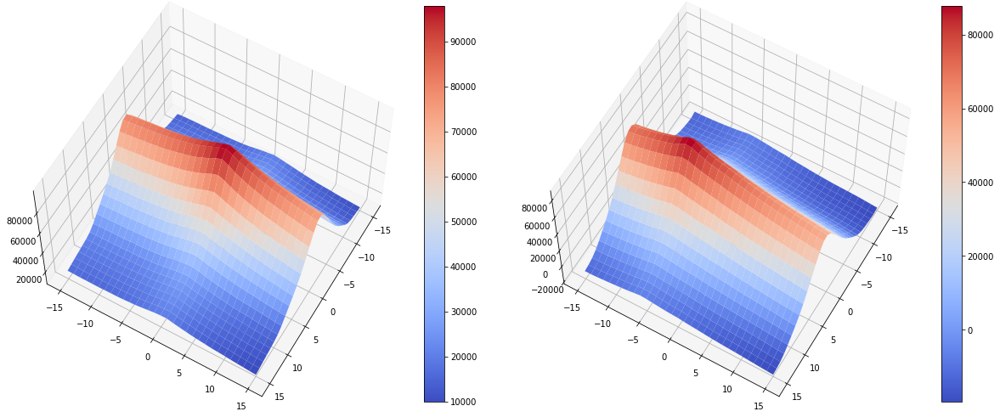

In [116]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [117]:
S1.max()+S2.max()

188436.09768992325

## Red channel

In [118]:
S1,y1,x1 = get_offset(norm(r),norm(b))
S2,y2,x2 = get_offset(norm(r),norm(g))
y1,x1,y2,x2

(7, -2, 6, -1)

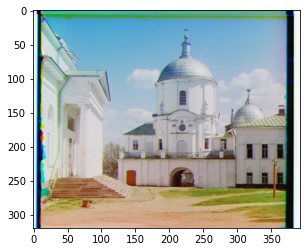

In [119]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_g = np.roll(g,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

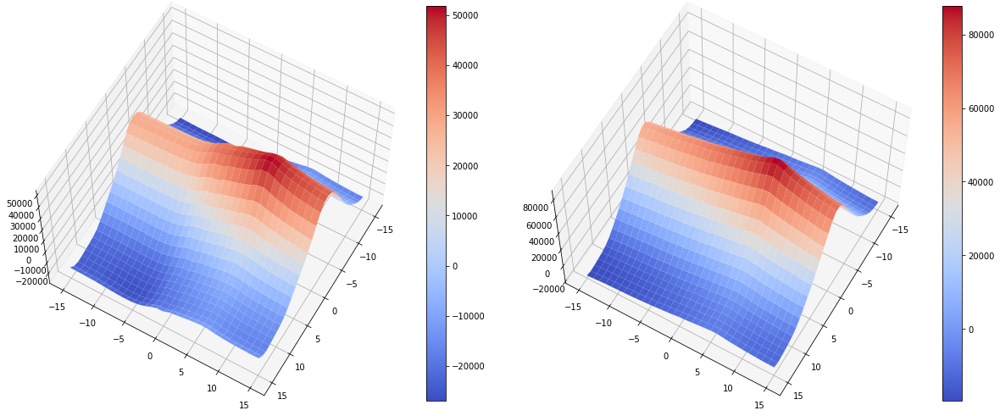

In [120]:
fig,ax = plt.subplots(1,2,figsize=(20,10),subplot_kw=dict(projection='3d'))
surf1 = ax[0].plot_surface(X, Y, S1,cmap = cm.coolwarm)
surf2 = ax[1].plot_surface(X, Y, S2,cmap = cm.coolwarm)
ax[0].view_init(60, 30)
ax[1].view_init(60, 30)
plt.colorbar(surf1, ax = ax[0],fraction=0.046, pad=0.04)
plt.colorbar(surf2, ax = ax[1],fraction=0.046, pad=0.04)

In [121]:
S1.max()+S2.max()

141375.89465288597

## Multiscaling image

In [122]:
def get_multi_offset(base,image,y_arr,x_arr):
    score = np.array([base.ravel()@np.roll(image,(dy,dx),axis=(0,1)).ravel() for dy in y_arr 
                     for dx in x_arr]).reshape(len(y_arr),len(x_arr))

    my,mx = np.unravel_index(score.argmax(),score.shape)
    
    offset_y = y_arr[my]
    offset_x = x_arr[mx]
    
    return score,offset_y, offset_x

In [123]:
def multi_process_offset(base,image):
    factor = 8
    y_tmp = np.arange(-20,21)
    x_tmp = np.arange(-20,21)
    for i in range(4):  
        base_tmp = base[::factor,::factor]
        image_tmp = image[::factor,::factor]
        S,y,x = get_multi_offset(norm(base_tmp),norm(image_tmp),y_tmp,x_tmp)
        factor = factor//2
        if y == 0:
            y += 1
        if x == 0 :
            x +=1
        y_tmp = np.arange(-4*abs(y),4*abs(y)+1)
        x_tmp = np.arange(-4*abs(x),4*abs(x)+1)
        #print(y_tmp)
        #print(x_tmp)
    return S,y, x

In [124]:
convert = lambda x: (x//256).astype(np.uint8)

(9656, 3741)

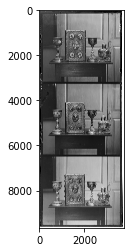

In [125]:
img = imread('01047u.tif')
# show the image
plt.imshow(img,cmap='gray')
img.shape

In [126]:
img = convert(img)

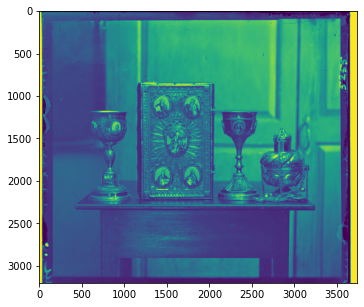

In [127]:
index = 50
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+3200])

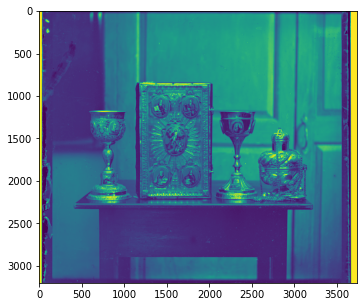

In [128]:
index = 3250
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+3200])

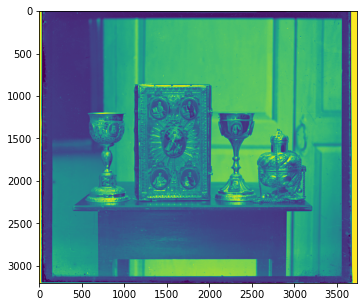

In [129]:
index = 6400
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+3200])

In [130]:
#b = img[100:100+3150]
b = img[50:50+3200]
#g = img[3250:3250+3150]
g = img[3250:3250+3200]
r = img[6400:6400+3200]
#r = img[6450:6450+3150]

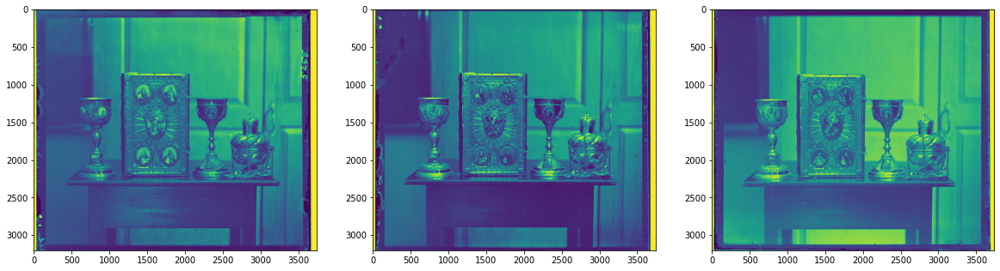

In [131]:
fig,ax = plt.subplots(1,3,figsize=(20,40))
ax[0].imshow(b)
ax[1].imshow(g)
ax[2].imshow(r)

## Blue channel as base image

In [132]:
def get_offset2(base,image):
    score = np.array([base.ravel()@np.roll(image,(dy,dx),axis=(0,1)).ravel() for dy in range(-20,21) 
                     for dx in range(-20,21)]).reshape(41,41)

    my,mx = np.unravel_index(score.argmax(),score.shape)
    dy = np.arange(-20,21)
    dx = np.arange(-20,21)
    offset_y = dy[my]
    offset_x = dx[mx]
    
    return score,offset_y, offset_x

In [133]:
t1 = time.time()
Sg,yg,xg = multi_process_offset(b,g)
Sr,yr,xr = multi_process_offset(b,r)
t2 = time.time()
print(t2-t1)

132.7353162765503


In [134]:
t1 = time.time()
_,_,_ = get_offset2(norm(b),norm(g))
_,_,_ = get_offset2(norm(b),norm(r))
t2 = time.time()
print(t2-t1)

202.73816394805908


In [135]:
len(np.arange(-20,21))

41

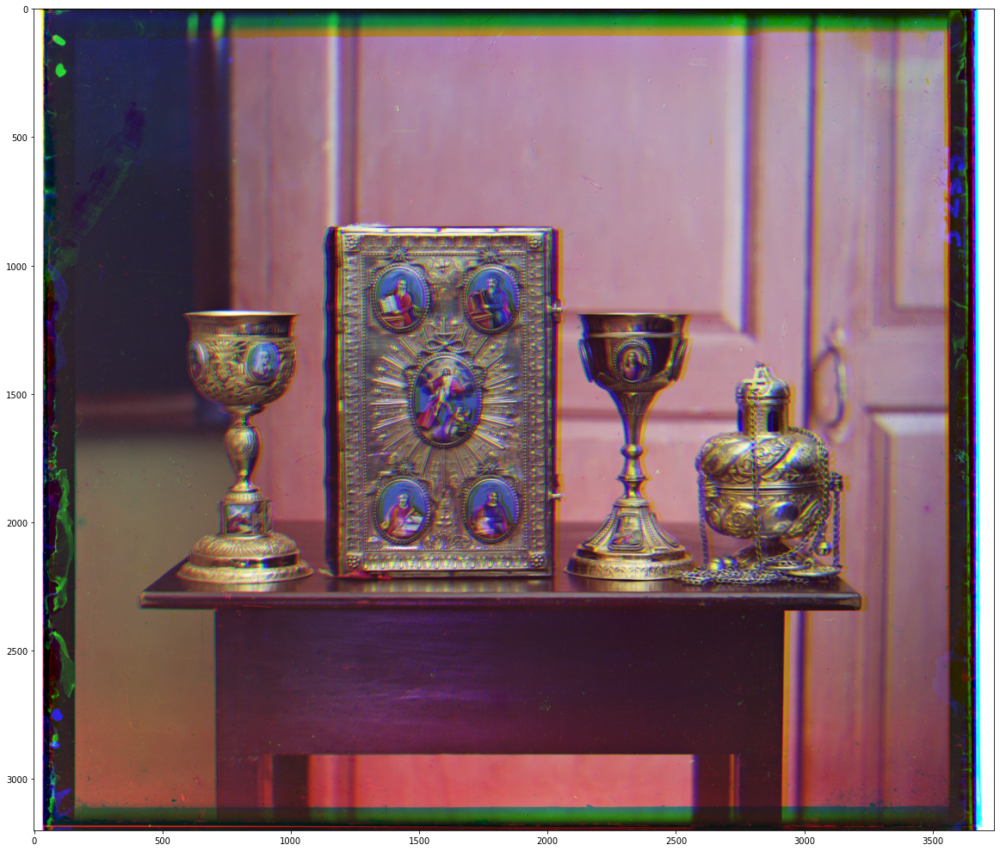

In [136]:
shifted_g = np.roll(g,(yg,xg),axis=(0,1)) 
shifted_r = np.roll(r,(yr,xr),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.figure(figsize=(20,20))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [137]:
Sr.max()+Sg.max()

18202888.444746982

In [138]:
(yg,xg),(yr,xr)

((7, 2), (-13, 8))

## Green channel

In [139]:
Sgb,ygb,xgb = multi_process_offset(g,b)
Sgr,ygr,xgr = multi_process_offset(g,r)

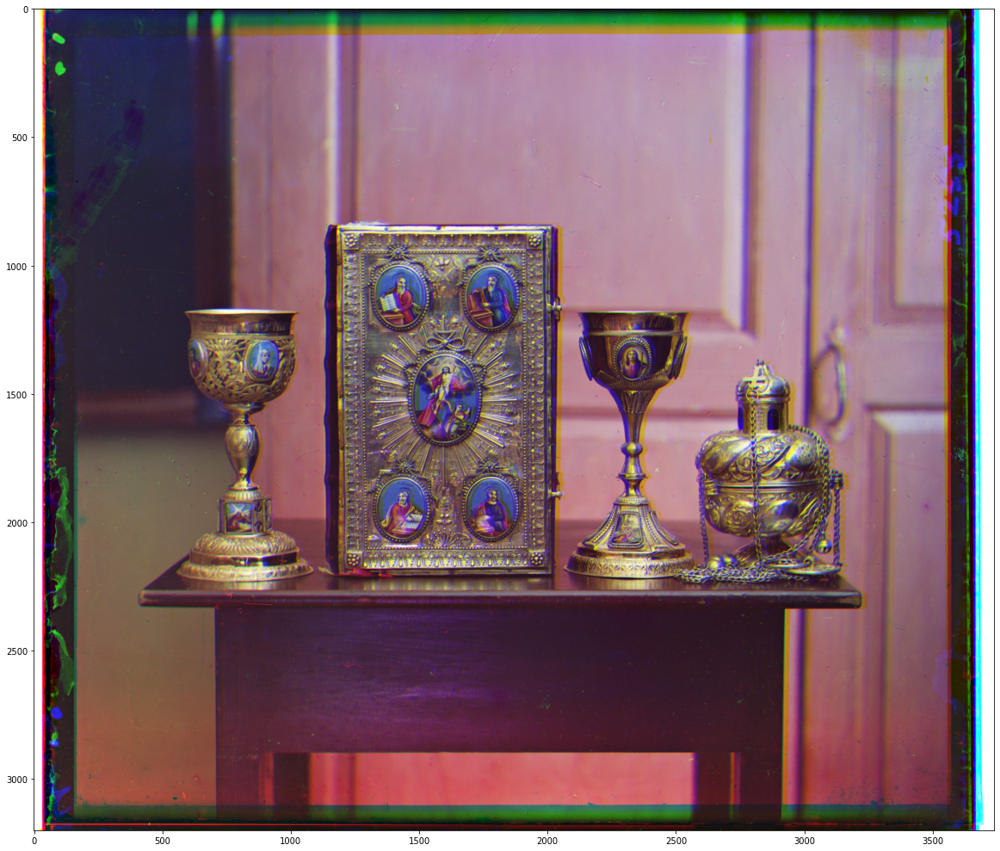

In [140]:
shifted_b = np.roll(b,(ygb,xgb),axis=(0,1)) 
shifted_r = np.roll(r,(ygr,xgr),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.figure(figsize=(20,20))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

In [141]:
Sgb.max()+Sgr.max()

19024622.594047457

In [142]:
(ygb,xgb),(ygr,xgr)

((-7, -2), (-21, 13))

## Red channel

In [143]:
Srg,yrg,xrg = multi_process_offset(r,g)
Srb,yrb,xrb = multi_process_offset(r,b)

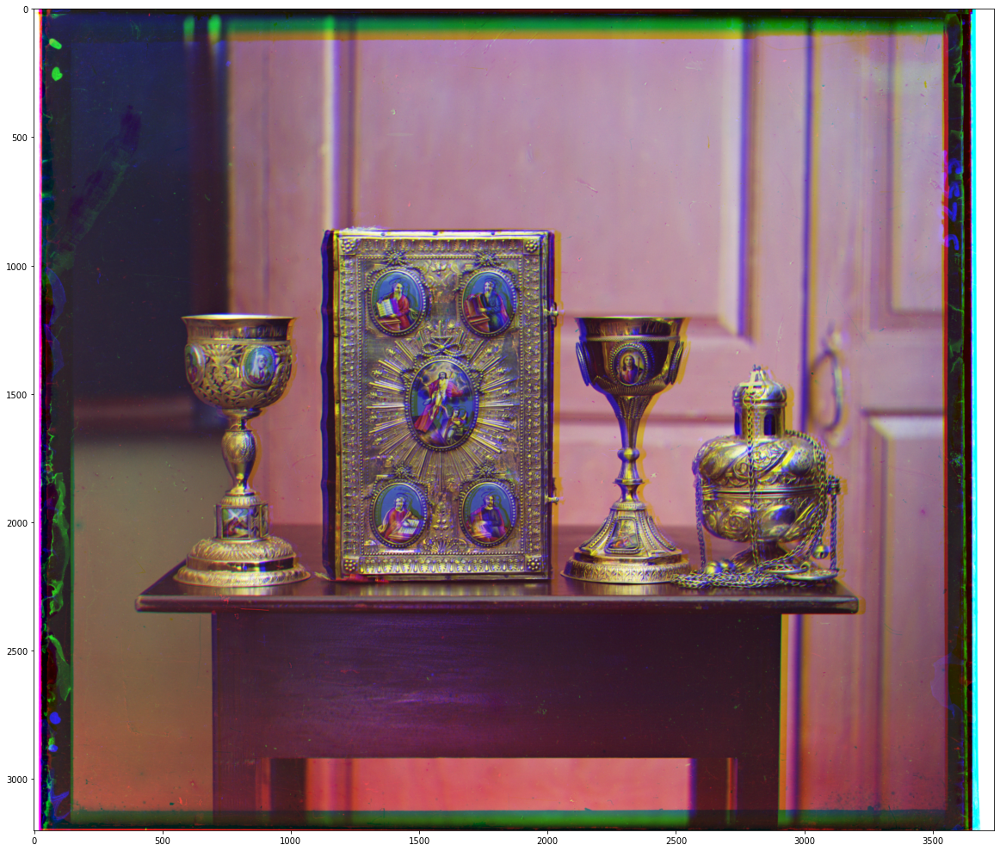

In [144]:
shifted_b = np.roll(b,(yrb,xrb),axis=(0,1)) 
shifted_g = np.roll(g,(yrg,xrg),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.figure(figsize=(20,20))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

In [145]:
Srg.max()+Srb.max()

18202595.99008018

In [146]:
(yrg,xrg),(yrb,xrb)

((21, -13), (13, -8))

## 2nd image

(9637, 3761)

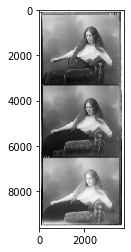

In [147]:
img = imread('01657u.tif')
# show the image
plt.imshow(img,cmap='gray')
img.shape

In [148]:
img = convert(img)

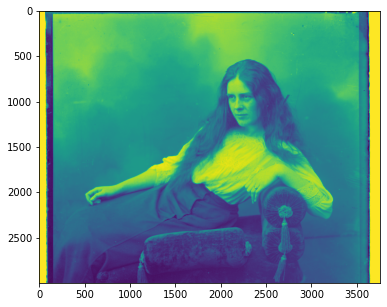

In [149]:
index = 190
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+3000])

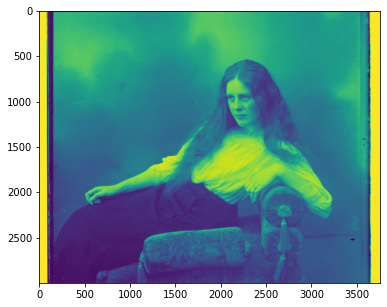

In [150]:
index = 3350
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+3000])

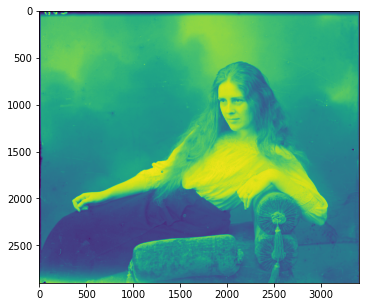

In [151]:
index = 6500
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+2900,150:-200])

In [152]:
b = img[190:190+3000,150:-200]
#b = img[190:190+3100]
g = img[3350:3350+3000,150:-200]
#g = img[3350:3350+3100]
#r = img[6500:6500+3100]
r = img[6500:6500+3000,150:-200]


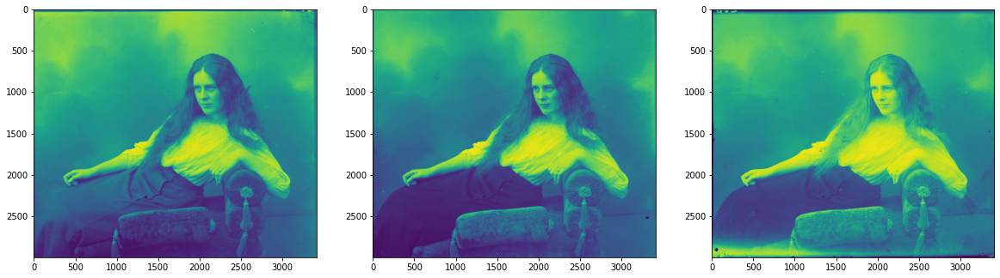

In [153]:
fig,ax = plt.subplots(1,3,figsize=(20,40))
ax[0].imshow(b)
ax[1].imshow(g)
ax[2].imshow(r)

## Blue channel

In [154]:
Sbg,ybg,xbg = multi_process_offset(b,g)
Sbr,ybr,xbr = multi_process_offset(b,r)

In [155]:
t1 = time.time()
_,_,_ = multi_process_offset(b,g)
_,_,_ = multi_process_offset(b,r)
t2 = time.time()
print(t2-t1)

30.716931581497192


In [156]:
t1 = time.time()
_,_,_ = get_offset2(norm(b),norm(g))
_,_,_ = get_offset2(norm(b),norm(r))
t2 = time.time()
print(t2-t1)

176.43413949012756


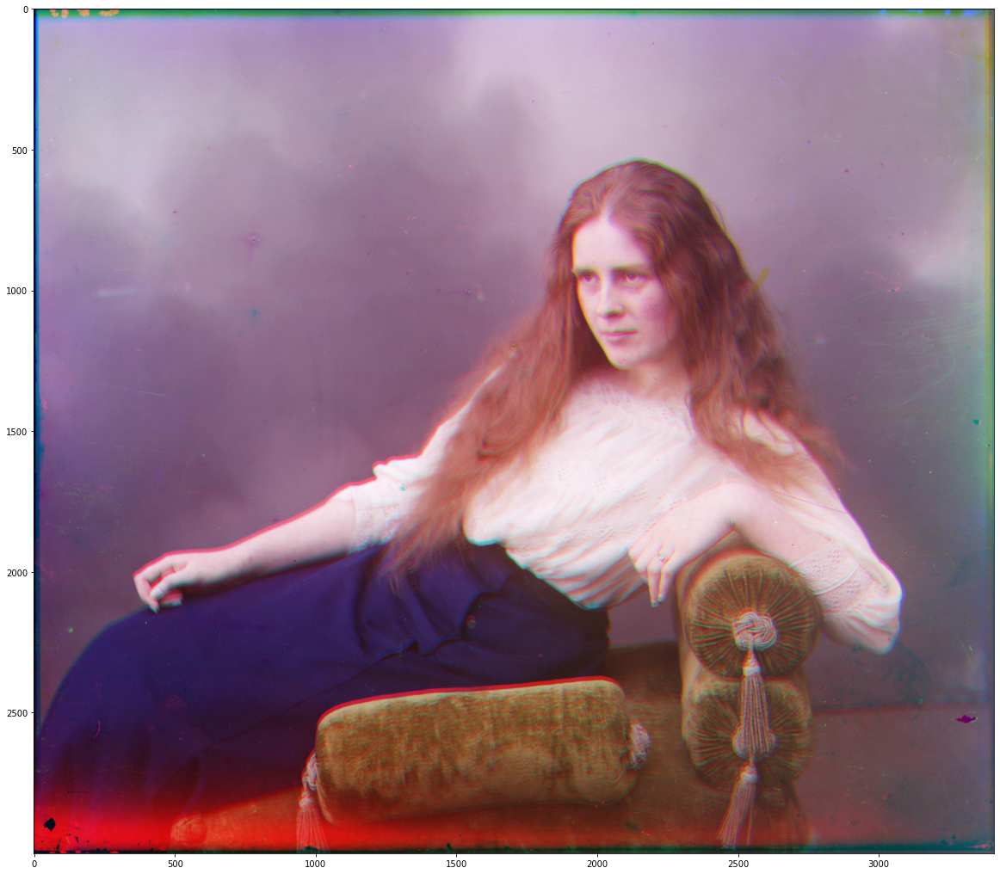

In [157]:
shifted_g = np.roll(g,(ybg,xbg),axis=(0,1)) 
shifted_r = np.roll(r,(ybr,xbr),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.figure(figsize=(20,20))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [158]:
ybg,xbg,ybr,xbr

(4, 1, -10, 1)

In [159]:
Sbg.max() + Sbr.max()

16809650.333611943

## Green channel

In [160]:
Sgb,ygb,xgb = multi_process_offset(g,b)
Sgr,ygr,xgr = multi_process_offset(g,r)

In [161]:
ygb,xgb,ygr+5,xgr

(-4, 1, 1, 3)

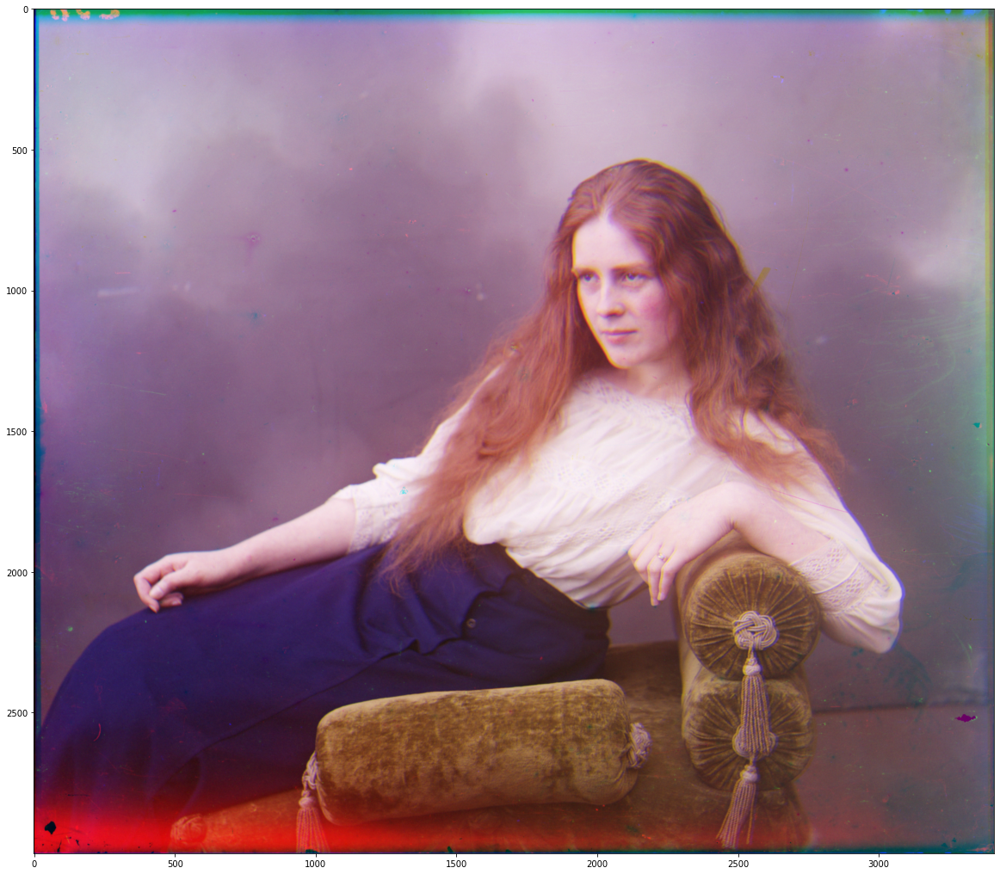

In [162]:
shifted_b = np.roll(b,(ygb,xgb),axis=(0,1)) 
shifted_r = np.roll(r,(ygr+5,xgr),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.figure(figsize=(20,20))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

In [163]:
Sgb.max() + Sgr.max()

17871593.827427603

## Red channel

In [164]:
Srb,yrb,xrb = multi_process_offset(r,b)
Srg,yrg,xrg = multi_process_offset(r,g)

In [165]:
yrb,xrb,yrg,xrg

(10, 1, 4, -3)

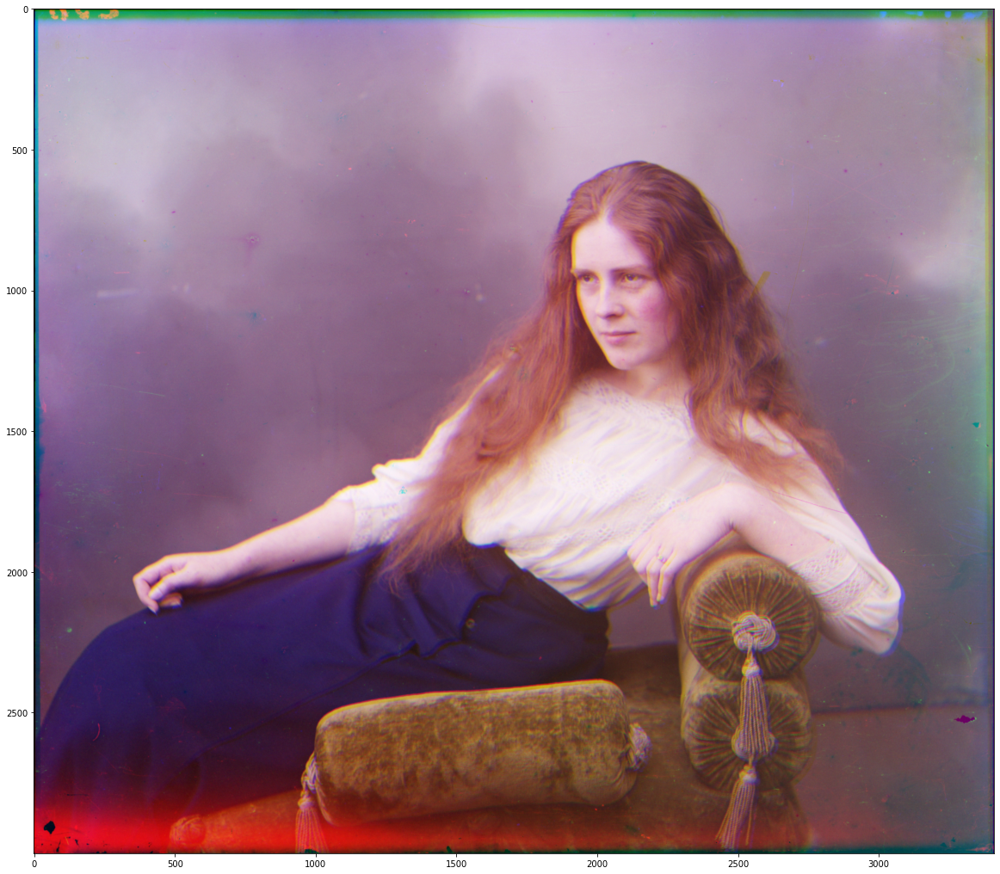

In [166]:
shifted_g = np.roll(g,(yrg,xrg),axis=(0,1)) 
shifted_b = np.roll(b,(yrb,xrb),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.figure(figsize=(20,20))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

In [167]:
Srb.max() + Srg.max()

15994713.524690362

## 3rd image

(9686, 3741)

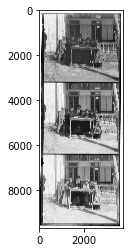

In [168]:
img = imread('01861a.tif')
# show the image
plt.imshow(img,cmap='gray')
img.shape

In [169]:
img = convert(img)

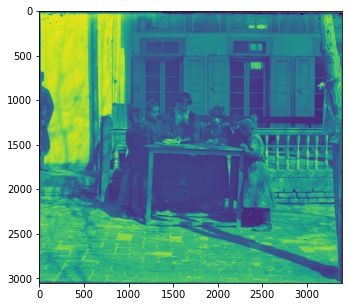

In [170]:
index = 140
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+3050,200:-150])

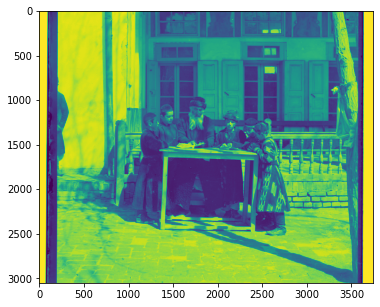

In [171]:
index = 3250
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+3050])

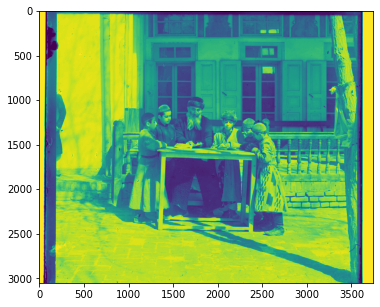

In [172]:
index = 6400
plt.figure(figsize=(20,5))
plt.imshow(img[index:index+3050])

In [173]:
b = img[140:140+3000]
#b = img[140:140+3050,200:-150]
#g = img[3250:3250+3050,200:-150]
g = img[3250:3250+3000]
r = img[6400:6400+3000]
#r = img[6400:6400+3050,200:-150]


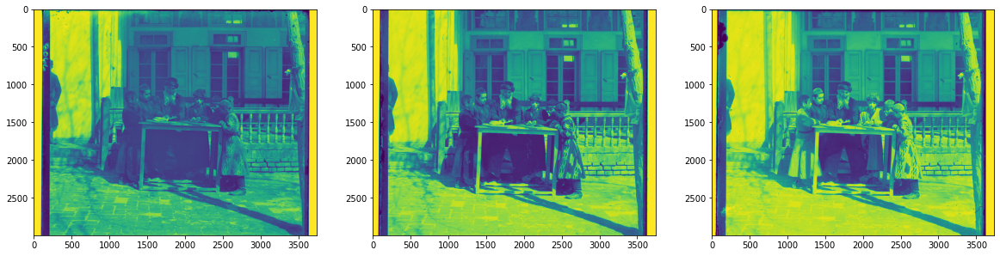

In [174]:
fig,ax = plt.subplots(1,3,figsize=(20,40))
ax[0].imshow(b)
ax[1].imshow(g)
ax[2].imshow(r)

## Blue channel

In [175]:
t1 = time.time()
_,_,_ = get_offset2(norm(b),norm(g))
_,_,_ = get_offset2(norm(b),norm(r))
t2 = time.time()
print(t2-t1)

132.61378836631775


In [176]:
b1 = b[::8]
g1 = g[::8]
r1 = r[::8]

In [177]:
t1 = time.time()
S1,y1,x1 = get_multi_offset(norm(b1),norm(g1),np.arange(-22,21),np.arange(-10,30))
S2,y2,x2 = get_multi_offset(norm(b1),norm(r1),np.arange(-20,11),np.arange(30,51))
t2 = time.time()
print(t2-t1)
print(y1,x1,y2,x2)


4.909782409667969
-6 24 -6 47


In [178]:
shifted_g = np.roll(g,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
#plt.figure(figsize=(20,20))
#plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [179]:
b2 = b[::4]
g2 = shifted_g[::4]
r2 = shifted_r[::4]

In [180]:
t1 = time.time()
S3,y3,x3 = get_multi_offset(norm(b2),norm(g2),np.arange(-20,11),np.arange(-10,11))
S4,y4,x4 = get_multi_offset(norm(b2),norm(r2),np.arange(-20,11),np.arange(-10,11))
t2 = time.time()
print(t2-t1)

5.7267749309539795


In [181]:
print(y3,x3,y4,x4)

-10 0 -11 0


In [182]:
shifted_g = np.roll(shifted_g,(y3,x3),axis=(0,1)) 
shifted_r = np.roll(shifted_r,(y4,x4),axis=(0,1))

#plt.figure(figsize=(10,10))
#plt.figure(figsize=(20,20))
#plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [183]:
b3 = b[::2]
g3 = shifted_g[::2]
r3 = shifted_r[::2]

In [184]:
t1 = time.time()
S5,y5,x5 = get_multi_offset(norm(b3),norm(g3),np.arange(-30,-11),np.arange(-5,6))
S6,y6,x6 = get_multi_offset(norm(b3),norm(r3),np.arange(-30,-11),np.arange(-5,6))
t2 = time.time()
print(t2-t1)

7.854364633560181


In [185]:
print(y5,x5,y6,x6)

-15 0 -16 0


In [186]:

shifted_g = np.roll(shifted_g,(y5,x5),axis=(0,1)) 
shifted_r = np.roll(shifted_r,(y6,x6),axis=(0,1))

#plt.figure(figsize=(10,10))
#plt.figure(figsize=(20,20))
#plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [187]:
t1 = time.time()
S7,y7,x7 = get_multi_offset(norm(b),norm(shifted_g),np.arange(-20,15),np.arange(-5,6))
S8,y8,x8 = get_multi_offset(norm(b),norm(shifted_r),np.arange(-20,15),np.arange(-5,6))
t2 = time.time()
print(t2-t1)
y7,x7,y8,x8

37.62556982040405


(-16, 0, -16, 0)

In [188]:
(y1+y3+y5+y7,x1+x3+x5+x7),(y2+y4+y6+y8,x2+x4+x6+x8)

((-47, 24), (-49, 47))

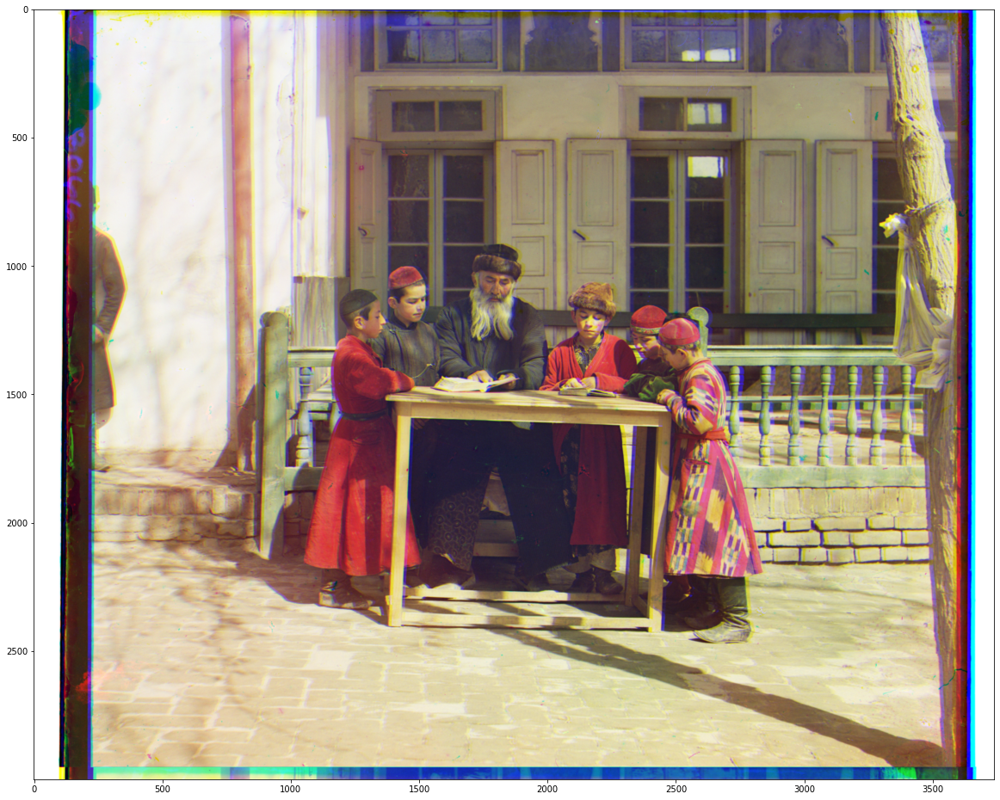

In [189]:
shifted_g = np.roll(shifted_g,(y7,x7),axis=(0,1)) 
shifted_r = np.roll(shifted_r,(y8,x8),axis=(0,1))
#plt.figure(figsize=(10,10))
plt.figure(figsize=(20,20))
plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [190]:
S7.max()+S8.max()

17433053.77413686

## Green channel base

In [191]:
b1 = b[::8]
g1 = g[::8]
r1 = r[::8]

In [192]:
S1,y1,x1 = get_multi_offset(norm(g1),norm(b1),np.arange(-12,11),np.arange(-40,0))
S2,y2,x2 = get_multi_offset(norm(g1),norm(r1),np.arange(-10,11),np.arange(0,30))
print(y1,x1,y2,x2)

6 -24 0 23


In [193]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_r = np.roll(r,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
#plt.figure(figsize=(20,20))
#plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [194]:
b2 = shifted_b[::4]
g2 = g[::4]
r2 = shifted_r[::4]

In [195]:
S3,y3,x3 = get_multi_offset(norm(g2),norm(b2),np.arange(-10,21),np.arange(-10,11))
S4,y4,x4 = get_multi_offset(norm(g2),norm(r2),np.arange(-10,21),np.arange(-10,11))


In [196]:
y3,x3,y4,x4

(10, 0, 0, 0)

In [197]:
shifted_b = np.roll(shifted_b,(y3,x3),axis=(0,1)) 
shifted_r = np.roll(shifted_r,(y4,x4),axis=(0,1))

#plt.figure(figsize=(10,10))
#plt.figure(figsize=(20,20))
#plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [198]:
b3 = shifted_b[::2]
g3 = g[::2]
r3 = shifted_r[::2]

In [199]:
S5,y5,x5 = get_multi_offset(norm(g3),norm(b3),np.arange(-0,20),np.arange(-5,6))
S6,y6,x6 = get_multi_offset(norm(g3),norm(r3),np.arange(-10,11),np.arange(-5,6))


In [200]:
y5,x5,y6,x6

(15, 0, -1, 0)

In [201]:
shifted_b = np.roll(shifted_b,(y5,x5),axis=(0,1)) 
shifted_r = np.roll(shifted_r,(y6,x6),axis=(0,1))

#plt.figure(figsize=(10,10))
#plt.figure(figsize=(20,20))
#plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [202]:
S7,y7,x7 = get_multi_offset(norm(g),norm(shifted_b),np.arange(-0,30),np.arange(-5,6))
S8,y8,x8 = get_multi_offset(norm(g),norm(shifted_r),np.arange(-10,11),np.arange(-5,6))
y7,x7,y8,x8

(16, 0, 0, 0)

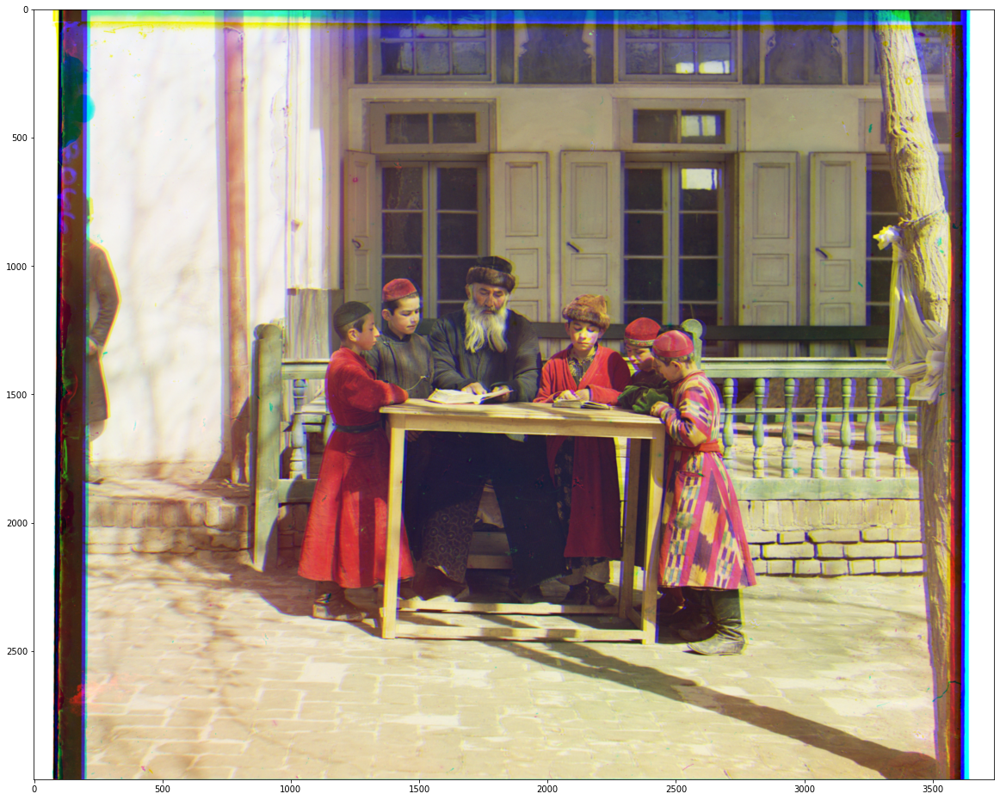

In [203]:
shifted_b = np.roll(shifted_b,(y7,x7),axis=(0,1)) 
shifted_r = np.roll(shifted_r,(y8,x8),axis=(0,1))

#plt.figure(figsize=(10,10))
plt.figure(figsize=(20,20))
plt.imshow(np.dstack((shifted_r,g,shifted_b)))

In [204]:
(y1+y3+y5+y7,x1+x3+x5+x7),(y2+y4+y6+y8,x2+x4+x6+x8)

((47, -24), (-1, 23))

In [205]:
S7.max()+S8.max()

19414036.36270553

## Red channel

In [206]:
b1 = b[::8]
g1 = g[::8]
r1 = r[::8]

In [207]:
S1,y1,x1 = get_multi_offset(norm(r1),norm(b1),np.arange(-12,11),np.arange(-60,-30))
S2,y2,x2 = get_multi_offset(norm(r1),norm(g1),np.arange(-10,11),np.arange(0,30))
print(y1,x1,y2,x2)

6 -47 0 0


In [208]:
shifted_b = np.roll(b,(y1,x1),axis=(0,1)) 
shifted_g = np.roll(g,(y2,x2),axis=(0,1))
#plt.figure(figsize=(10,10))
#plt.figure(figsize=(20,20))
#plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [209]:
b2 = shifted_b[::4]
g2 = shifted_g[::4]
r2 = r[::4]

In [210]:
S3,y3,x3 = get_multi_offset(norm(r2),norm(b2),np.arange(-10,21),np.arange(-6,6))
S4,y4,x4 = get_multi_offset(norm(r2),norm(g2),np.arange(-10,21),np.arange(-30,6))


In [211]:
y3,x3,y4,x4

(11, 0, 0, -23)

In [212]:
shifted_b = np.roll(shifted_b,(y3,x3),axis=(0,1)) 
shifted_g = np.roll(shifted_g,(y4,x4),axis=(0,1))

#plt.figure(figsize=(10,10))
#plt.figure(figsize=(20,20))
#plt.imshow(np.dstack((shifted_r,shifted_g,b)))

In [213]:
b3 = shifted_b[::2]
g3 = shifted_g[::2]
r3 = r[::2]

In [214]:
S5,y5,x5 = get_multi_offset(norm(r3),norm(b3),np.arange(-0,20),np.arange(-5,6))
S6,y6,x6 = get_multi_offset(norm(r3),norm(g3),np.arange(-10,11),np.arange(-5,6))


In [215]:
y5,x5,y6,x6

(16, 0, 1, 0)

In [216]:
shifted_b = np.roll(shifted_b,(y5,x5),axis=(0,1)) 
shifted_g = np.roll(shifted_g,(y6,x6),axis=(0,1))


In [217]:
S7,y7,x7 = get_multi_offset(norm(r),norm(shifted_b),np.arange(-0,30),np.arange(-5,6))
S8,y8,x8 = get_multi_offset(norm(r),norm(shifted_g),np.arange(-10,11),np.arange(-5,6))
y7,x7,y8,x8

(16, 0, 0, 0)

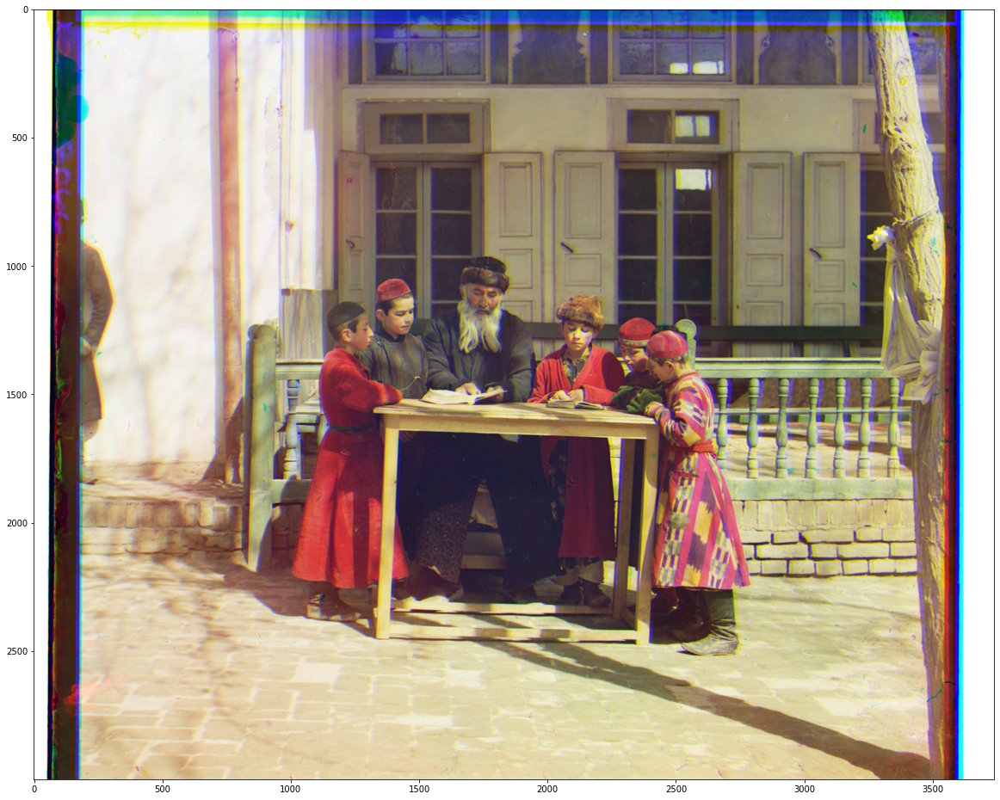

In [218]:
shifted_b = np.roll(shifted_b,(y7,x7),axis=(0,1)) 
shifted_g = np.roll(shifted_g,(y8,x8),axis=(0,1))

#plt.figure(figsize=(10,10))
plt.figure(figsize=(20,20))
plt.imshow(np.dstack((r,shifted_g,shifted_b)))

In [219]:
S7.max()+S8.max()

18137202.00707929

In [220]:
(y1+y3+y5+y7,x1+x3+x5+x7),(y2+y4+y6+y8,x2+x4+x6+x8)

((49, -47), (1, -23))